<a href="https://colab.research.google.com/github/sabbasi-1/Colorize/blob/main/Img_Colorizer_CV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Replicating Paper Results

We're going to be usiong the following paper as our baseline: https://arxiv.org/abs/1611.07004

In [ ]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

## 1.1 Installing Dependencies

In [ ]:
!pip install fastai==2.4

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 187.9/187.9 KB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 831.4/831.4 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.0/56.0 KB 9.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.2/24.2 MB 63.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.3/24.3 MB 67.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 76.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 19.1/19.1 MB 18.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.0/21.0 MB 72.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.2/23.2 MB 75.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.3/23.3 MB 66.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.3/23.3 MB 17.6 MB/s eta 0:00:00
     ━━━━━━

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"
use_colab = True

In [ ]:
if use_colab == True:
    path = coco_path
else:
    path = "Your path to the dataset"

paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000, replace=False) # choosing 1000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:8000] # choosing the first 8000 as training set
val_idxs = rand_idxs[8000:] # choosing last 2000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

8000 2000


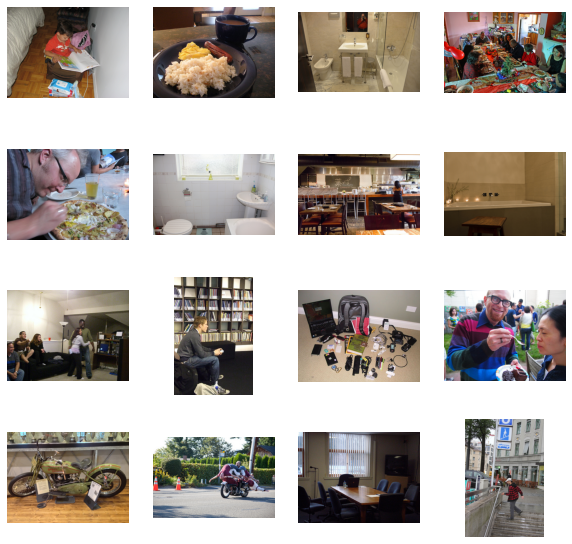

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

## 1.2 Making the dataset

We're making a dataset that achieves the following:


*   Resizes and flips images for coherence
*   Takes RGB image as input and splits it into color and grayscale components.



In [ ]:
SIZE = 256
class ColorizationDataset(Dataset):
    def __init__(self, paths, split='train'):
        if split == 'train':
            self.transforms = transforms.Compose([
                transforms.Resize((SIZE, SIZE),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), #data augmentation to increase dataset
            ])
        elif split == 'val':
            self.transforms = transforms.Resize((SIZE, SIZE),  Image.BICUBIC)

        self.split = split
        self.size = SIZE
        self.paths = paths

    def __getitem__(self, idx):
        img = Image.open(self.paths[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1

        return {'L': L, 'ab': ab}

    def __len__(self):
        return len(self.paths)

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.8/dist-packages/torchvision/transforms/transforms.py:329: UserWarning: Argument 'interpolation' of type int is deprecated since 0.13 and will be removed in 0.15. Please use InterpolationMode enum.
  self.size = _setup_size(size, error_msg="Please provide only two dimensions (h, w) for size.")
/usr/local/lib/python3.8/dist-packages/torch/utils/data/dataloader.py:554: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  assert self._num_workers == 0


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


## 1.3 Constructing a Generator for the GAN

Generator is based on the model provided within the paper.

In [ ]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)

    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        return self.model(x)

## 1.4 Constructing a Discriminator for the GAN

Both the generator and discriminator have been taken from the online repository provided.

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2)
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)

    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True):
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

In [ ]:
#viewing the contents
PatchDiscriminator(3)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

## 1.5 Calculating Loss

In [ ]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        if gan_mode == 'vanilla':
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            self.loss = nn.MSELoss()

    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)

    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

## 1.6 Initializing the Model

initializing the weights using a mean of 0.0 and S.D of 0.02, values provided within the paper

In [ ]:
def init_weights(net, init='norm', gain=0.02):

    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [ ]:
#Putting it Together

class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=2e-4, lr_D=2e-4,
                 beta1=0.5, beta2=0.999, lambda_L1=100.):
        super().__init__()

        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_color = self.net_G(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()

        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

## 1.7 Defining Visualization Parameters

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()

    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3

    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()

    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """

    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")

def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

## 1.8 Training

In [ ]:

def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data)
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs
model = MainModel()
"""
train_model(model, train_dl, 50)
"""

model initialized with norm initialization
model initialized with norm initialization


'\ntrain_model(model, train_dl, 50)\n'

# Section 2: Improvements to the Code

The same task can be accelerated by pretraining the genereator. By doing so, similar results can be obtained for lesser epochs.

Incase you don't wish to retrain the model and just want to see it in action, **just run 2.1 and 2.2** and move over to section 3.

##  2.1 Adding Dependencies

In [ ]:
! pip install fastai==2.4
from fastai.vision.learner import create_body
from torchvision.models.resnet import resnet18
from fastai.vision.models.unet import DynamicUnet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## 2.2 Pretraining Model

In [ ]:
def build_res_unet(n_input=1, n_output=2, size=256):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    body = create_body(resnet18, pretrained=True, n_in=n_input, cut=-2)
    net_G = DynamicUnet(body, n_output, (size, size)).to(device)
    return net_G

**NOTE: You may rerun this function to see it work if you have the time. Pretraining will take about an hour**

In [ ]:
def pretrain_generator(net_G, train_dl, opt, criterion, epochs):
    for e in range(epochs):
        loss_meter = AverageMeter()
        for data in tqdm(train_dl):
            L, ab = data['L'].to(device), data['ab'].to(device)
            preds = net_G(L)
            loss = criterion(preds, ab)
            opt.zero_grad()
            loss.backward()
            opt.step()

            loss_meter.update(loss.item(), L.size(0))

        print(f"Epoch {e + 1}/{epochs}")
        print(f"L1 Loss: {loss_meter.avg:.5f}")

net_G = build_res_unet(n_input=1, n_output=2, size=256)
opt = optim.Adam(net_G.parameters(), lr=1e-4)
criterion = nn.L1Loss()
#pretrain_generator(net_G, train_dl, opt, criterion, 10)

/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
/usr/local/lib/python3.8/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

# 2.3 Retraining the Model

Again, training will require alot of time(one epoch will take about 4-5 minutes)

In [ ]:
torch.save(net_G.state_dict(), "res18-unet.pt")

model initialized with norm initialization


  0%|          | 0/500 [00:00<?, ?it/s]

<ipython-input-13-c387718a1569>:33: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  fake_image = torch.cat([self.L, self.fake_color], dim=1)
<ipython-input-13-c387718a1569>:34: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  fake_preds = self.net_D(fake_image.detach())
/usr/local/lib/python3.8/dist-packages/torch/nn/modules/conv.py:459: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  This module supports :ref:`TensorFloat32<tf32_on_ampere>`.
/usr/local/lib/python3.8/dist-pa


Epoch 1/20
Iteration 200/500
loss_D_fake: 0.48303
loss_D_real: 0.48969
loss_D: 0.48636
loss_G_GAN: 1.50380
loss_G_L1: 10.17166
loss_G: 11.67546


<ipython-input-14-9d67ed3ddef9>:53: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  fake_color = model.fake_color.detach()
<ipython-input-14-9d67ed3ddef9>:40: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()


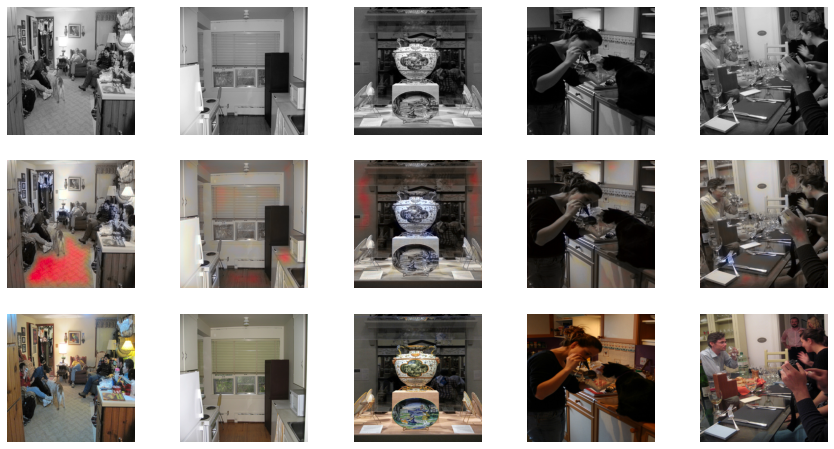


Epoch 1/20
Iteration 400/500
loss_D_fake: 0.47623
loss_D_real: 0.49228
loss_D: 0.48426
loss_G_GAN: 1.52374
loss_G_L1: 10.05269
loss_G: 11.57643


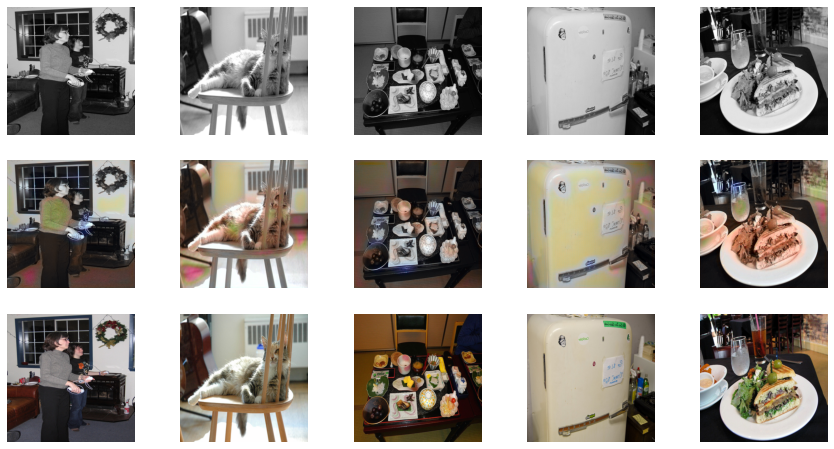

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/20
Iteration 200/500
loss_D_fake: 0.51813
loss_D_real: 0.52993
loss_D: 0.52403
loss_G_GAN: 1.37046
loss_G_L1: 10.32247
loss_G: 11.69292


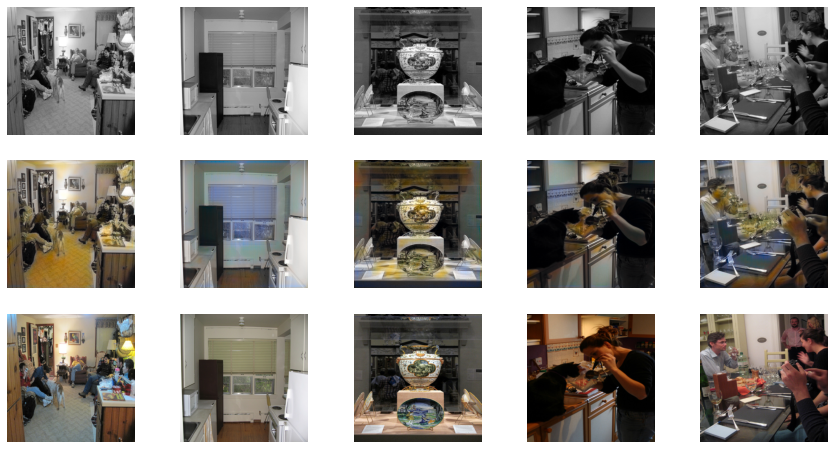


Epoch 2/20
Iteration 400/500
loss_D_fake: 0.52850
loss_D_real: 0.55233
loss_D: 0.54042
loss_G_GAN: 1.30811
loss_G_L1: 10.23975
loss_G: 11.54786


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


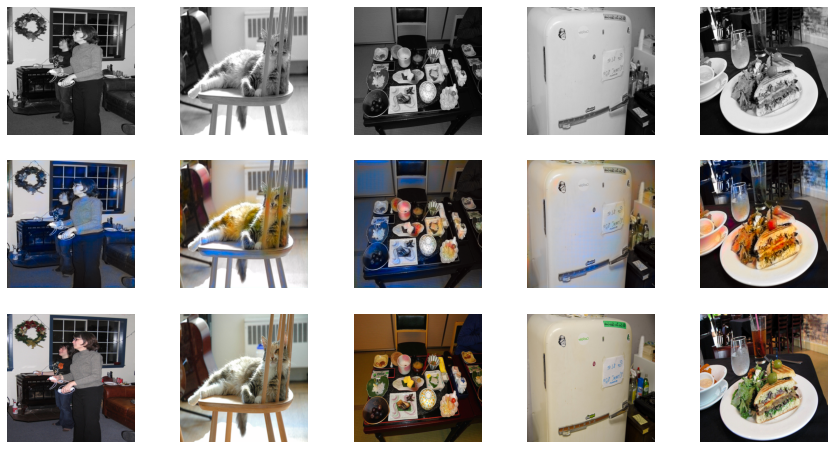

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/20
Iteration 200/500
loss_D_fake: 0.54575
loss_D_real: 0.58254
loss_D: 0.56415
loss_G_GAN: 1.18593
loss_G_L1: 9.99733
loss_G: 11.18326


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 53 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 42 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 131 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Colo

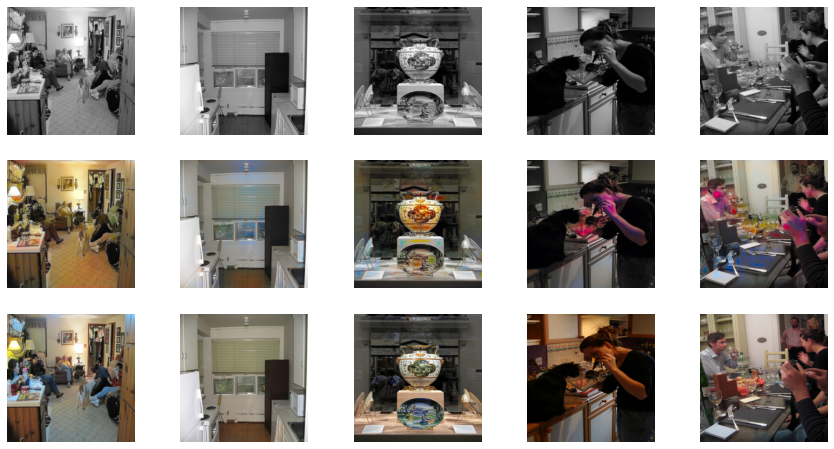


Epoch 3/20
Iteration 400/500
loss_D_fake: 0.54589
loss_D_real: 0.58617
loss_D: 0.56603
loss_G_GAN: 1.18022
loss_G_L1: 9.93296
loss_G: 11.11318


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


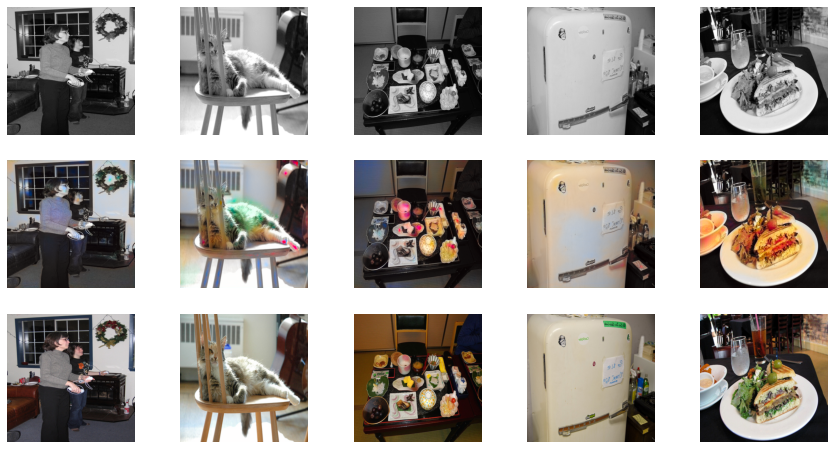

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/20
Iteration 200/500
loss_D_fake: 0.53644
loss_D_real: 0.60151
loss_D: 0.56898
loss_G_GAN: 1.16406
loss_G_L1: 9.89725
loss_G: 11.06131


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


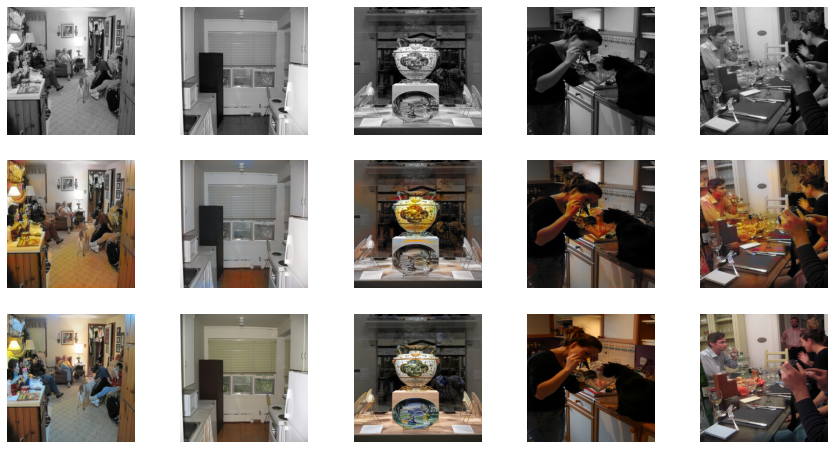


Epoch 4/20
Iteration 400/500
loss_D_fake: 0.54650
loss_D_real: 0.61154
loss_D: 0.57902
loss_G_GAN: 1.13983
loss_G_L1: 9.82281
loss_G: 10.96265


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 23 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


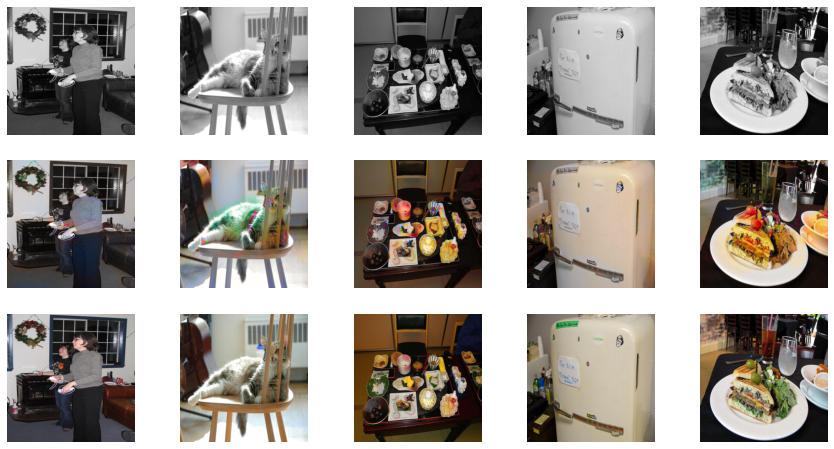

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/20
Iteration 200/500
loss_D_fake: 0.55796
loss_D_real: 0.61701
loss_D: 0.58749
loss_G_GAN: 1.10021
loss_G_L1: 9.75995
loss_G: 10.86016


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


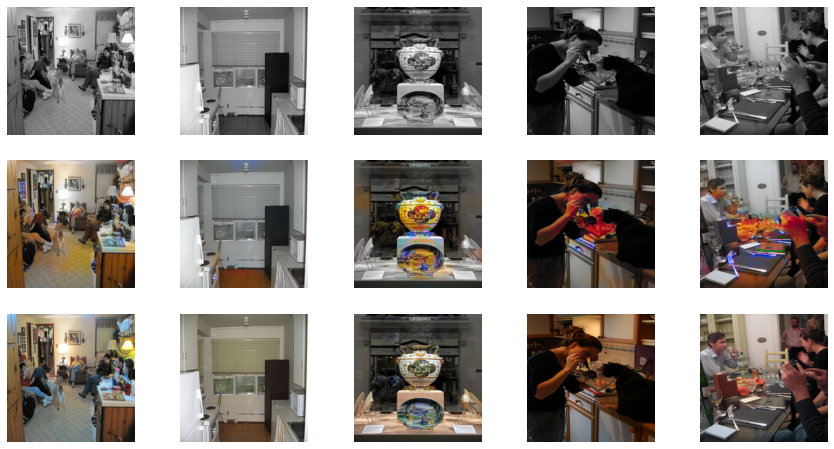


Epoch 5/20
Iteration 400/500
loss_D_fake: 0.56427
loss_D_real: 0.61931
loss_D: 0.59179
loss_G_GAN: 1.09272
loss_G_L1: 9.67543
loss_G: 10.76815


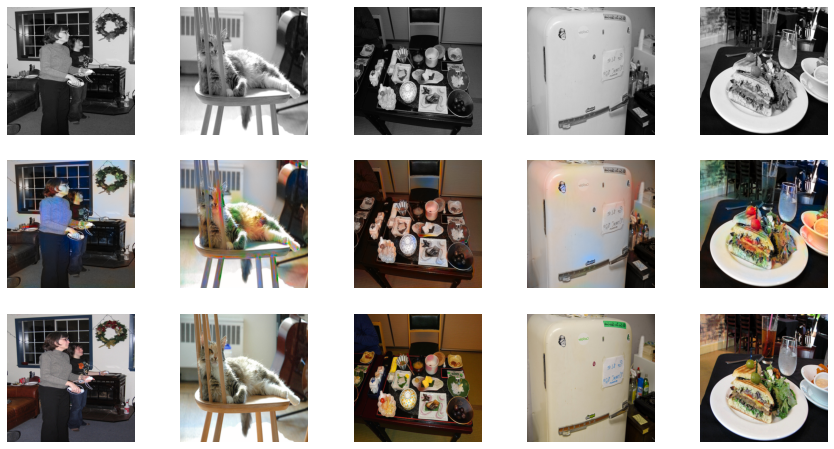

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/20
Iteration 200/500
loss_D_fake: 0.56927
loss_D_real: 0.62285
loss_D: 0.59606
loss_G_GAN: 1.06304
loss_G_L1: 9.60547
loss_G: 10.66851


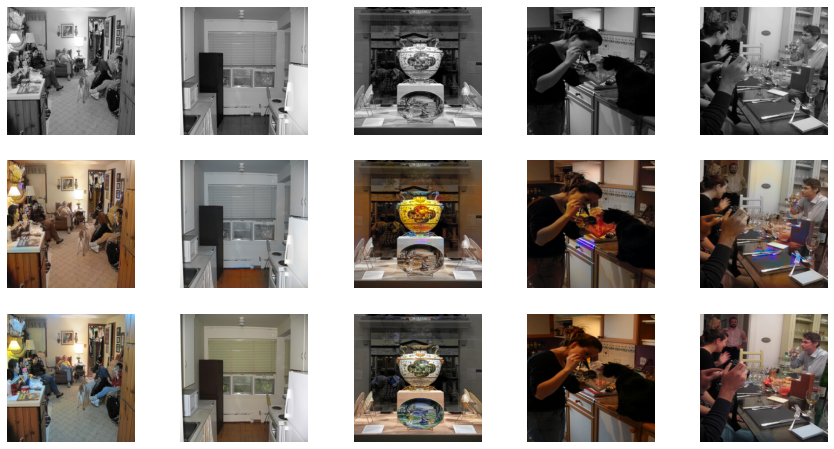


Epoch 6/20
Iteration 400/500
loss_D_fake: 0.57297
loss_D_real: 0.62776
loss_D: 0.60037
loss_G_GAN: 1.05971
loss_G_L1: 9.47134
loss_G: 10.53104


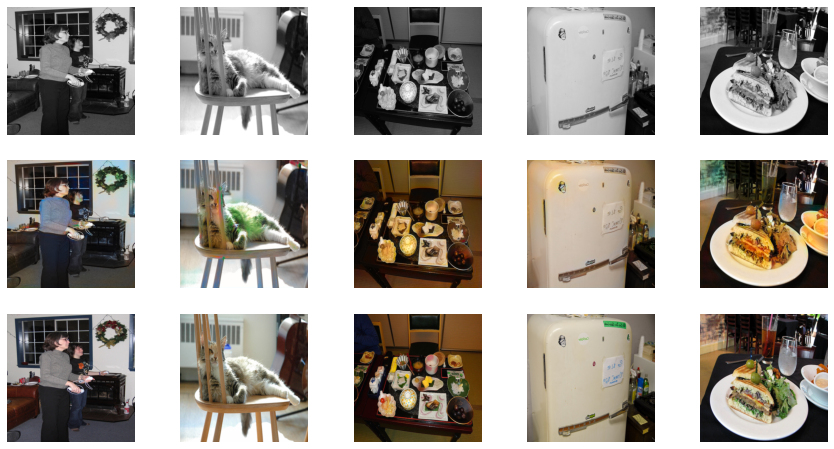

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/20
Iteration 200/500
loss_D_fake: 0.57298
loss_D_real: 0.61814
loss_D: 0.59556
loss_G_GAN: 1.03075
loss_G_L1: 9.38672
loss_G: 10.41748


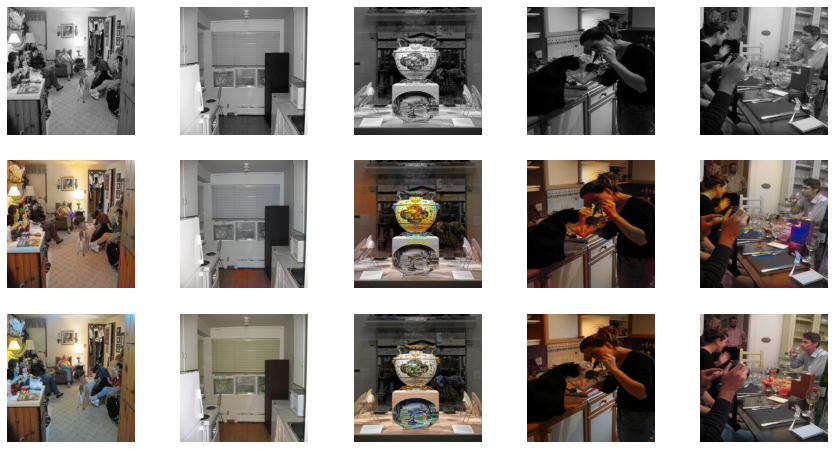


Epoch 7/20
Iteration 400/500
loss_D_fake: 0.57879
loss_D_real: 0.62461
loss_D: 0.60170
loss_G_GAN: 1.02539
loss_G_L1: 9.30426
loss_G: 10.32965


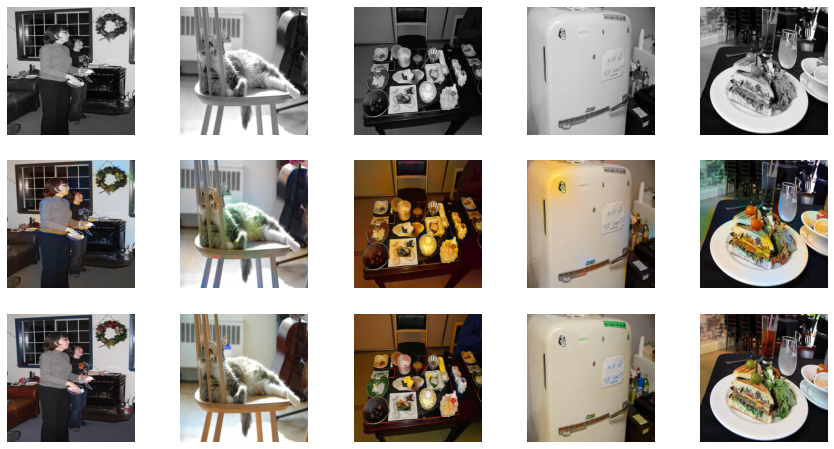

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/20
Iteration 200/500
loss_D_fake: 0.57571
loss_D_real: 0.62597
loss_D: 0.60084
loss_G_GAN: 1.01901
loss_G_L1: 9.18997
loss_G: 10.20897


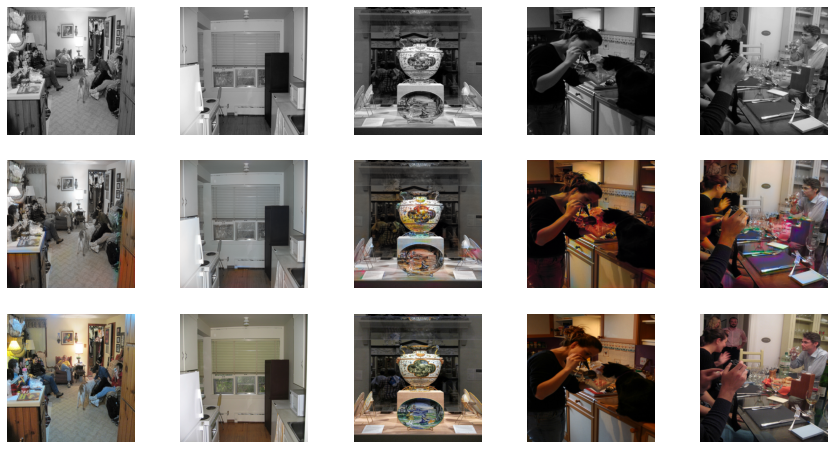


Epoch 8/20
Iteration 400/500
loss_D_fake: 0.57847
loss_D_real: 0.63028
loss_D: 0.60437
loss_G_GAN: 1.01955
loss_G_L1: 9.09803
loss_G: 10.11758


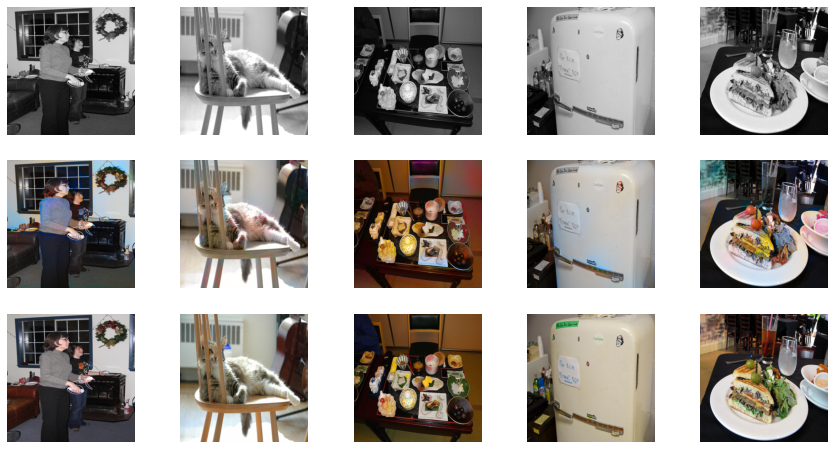

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/20
Iteration 200/500
loss_D_fake: 0.57793
loss_D_real: 0.62542
loss_D: 0.60167
loss_G_GAN: 1.01942
loss_G_L1: 8.95949
loss_G: 9.97891


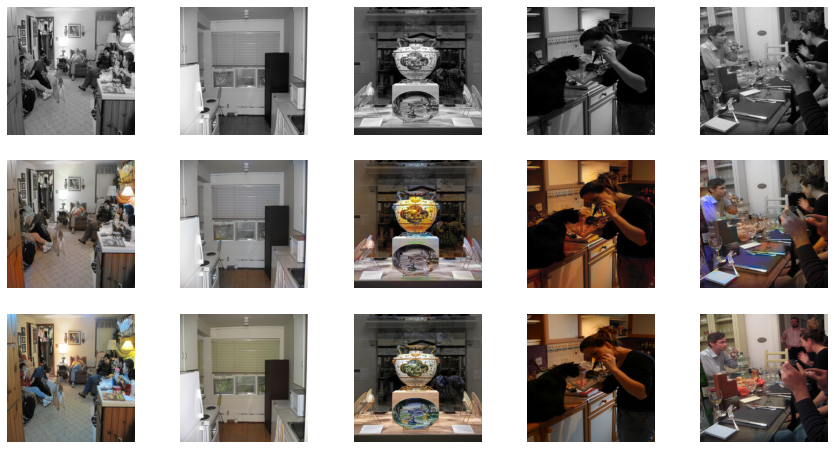


Epoch 9/20
Iteration 400/500
loss_D_fake: 0.58079
loss_D_real: 0.62850
loss_D: 0.60465
loss_G_GAN: 1.01532
loss_G_L1: 8.87140
loss_G: 9.88672


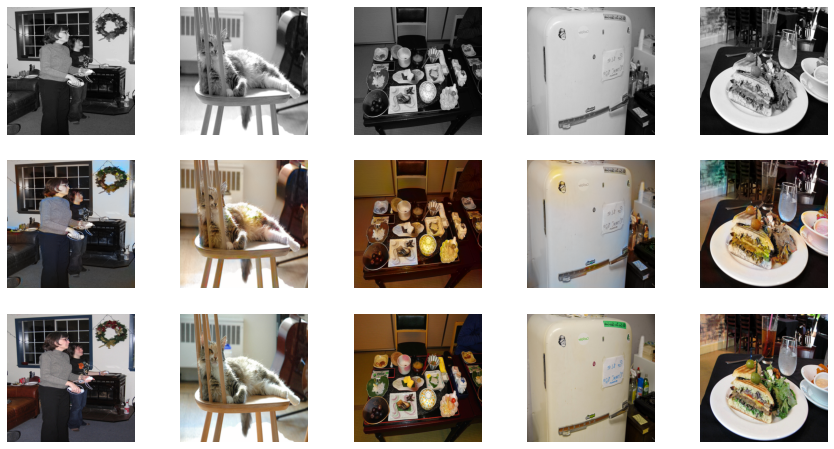

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/20
Iteration 200/500
loss_D_fake: 0.57678
loss_D_real: 0.62819
loss_D: 0.60248
loss_G_GAN: 1.01323
loss_G_L1: 8.76997
loss_G: 9.78321


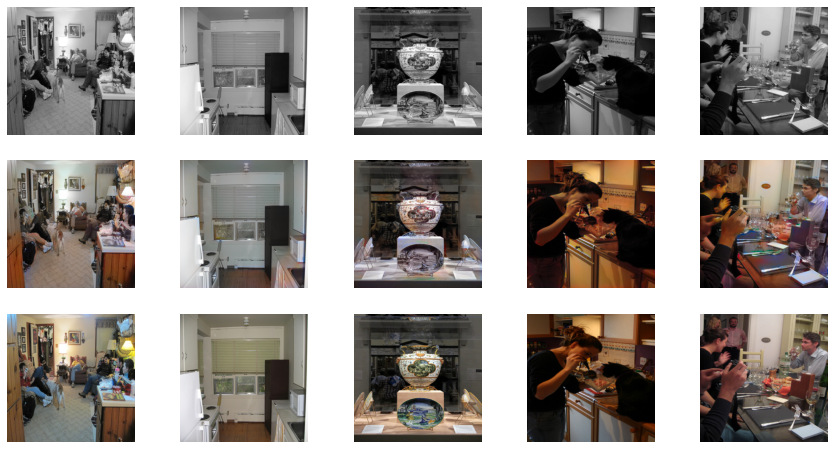


Epoch 10/20
Iteration 400/500
loss_D_fake: 0.58272
loss_D_real: 0.63212
loss_D: 0.60742
loss_G_GAN: 1.01220
loss_G_L1: 8.69798
loss_G: 9.71018


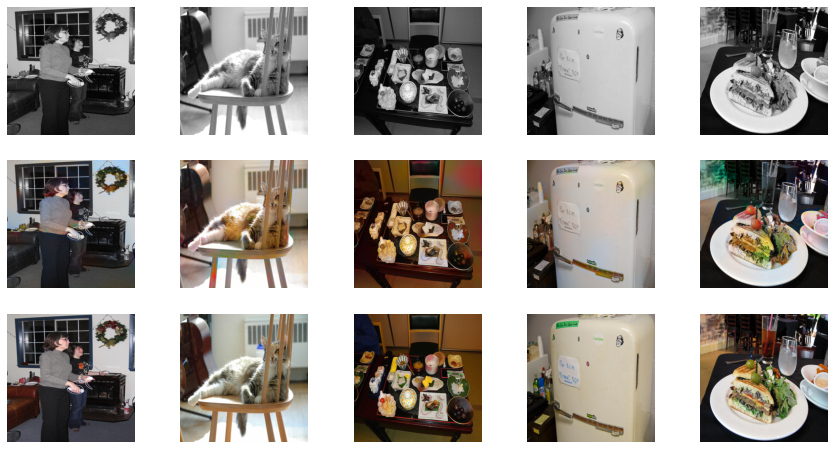

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/20
Iteration 200/500
loss_D_fake: 0.58252
loss_D_real: 0.62535
loss_D: 0.60394
loss_G_GAN: 1.01525
loss_G_L1: 8.54377
loss_G: 9.55902


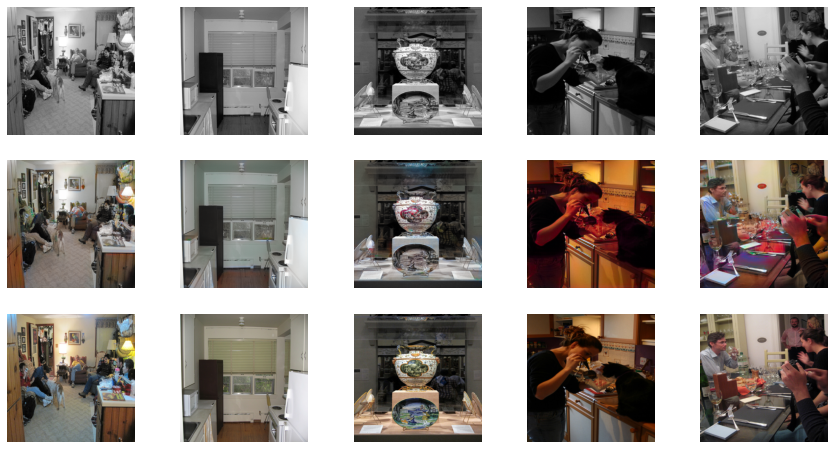


Epoch 11/20
Iteration 400/500
loss_D_fake: 0.58614
loss_D_real: 0.63003
loss_D: 0.60809
loss_G_GAN: 1.00542
loss_G_L1: 8.45794
loss_G: 9.46336


/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


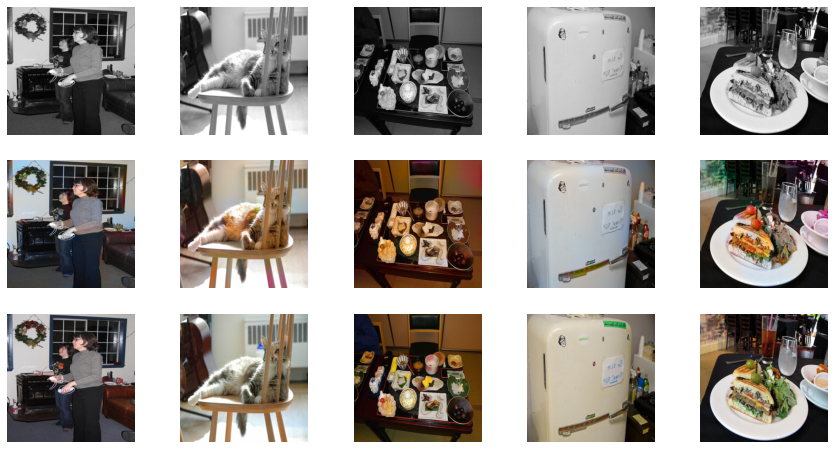

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/20
Iteration 200/500
loss_D_fake: 0.58277
loss_D_real: 0.62740
loss_D: 0.60509
loss_G_GAN: 1.00769
loss_G_L1: 8.35412
loss_G: 9.36181


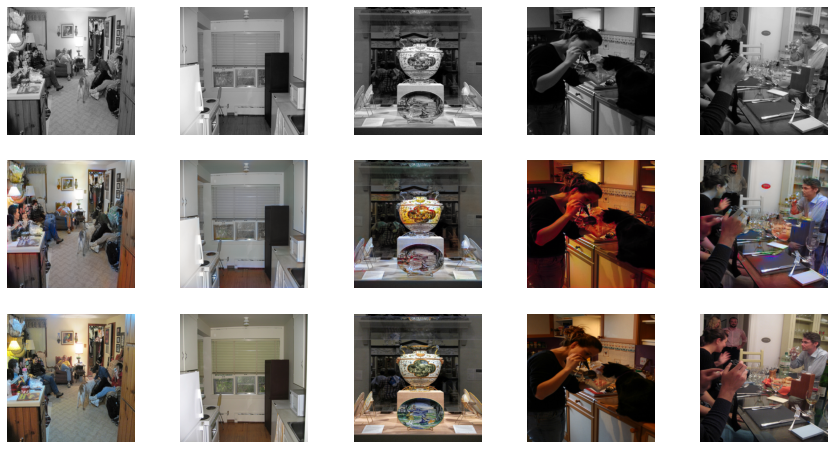


Epoch 12/20
Iteration 400/500
loss_D_fake: 0.58904
loss_D_real: 0.63207
loss_D: 0.61055
loss_G_GAN: 1.00063
loss_G_L1: 8.28608
loss_G: 9.28671


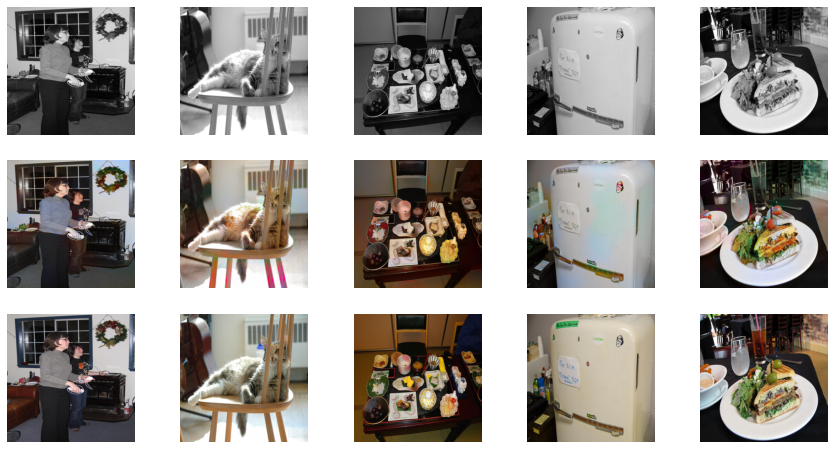

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/20
Iteration 200/500
loss_D_fake: 0.58864
loss_D_real: 0.63357
loss_D: 0.61110
loss_G_GAN: 0.99573
loss_G_L1: 8.20455
loss_G: 9.20029


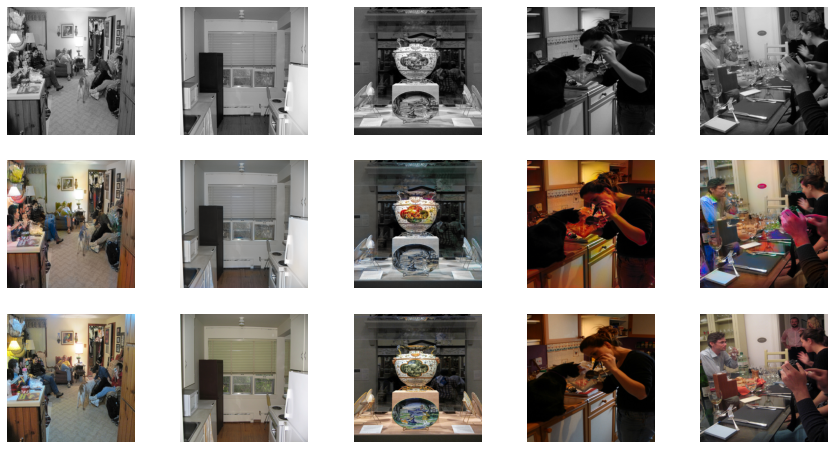


Epoch 13/20
Iteration 400/500
loss_D_fake: 0.59177
loss_D_real: 0.63444
loss_D: 0.61310
loss_G_GAN: 0.98945
loss_G_L1: 8.10588
loss_G: 9.09532


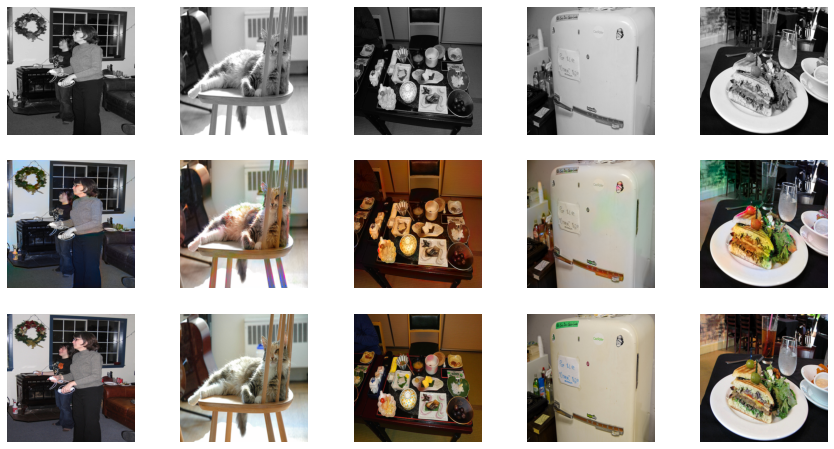

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/20
Iteration 200/500
loss_D_fake: 0.59418
loss_D_real: 0.63291
loss_D: 0.61354
loss_G_GAN: 0.98635
loss_G_L1: 8.01769
loss_G: 9.00404


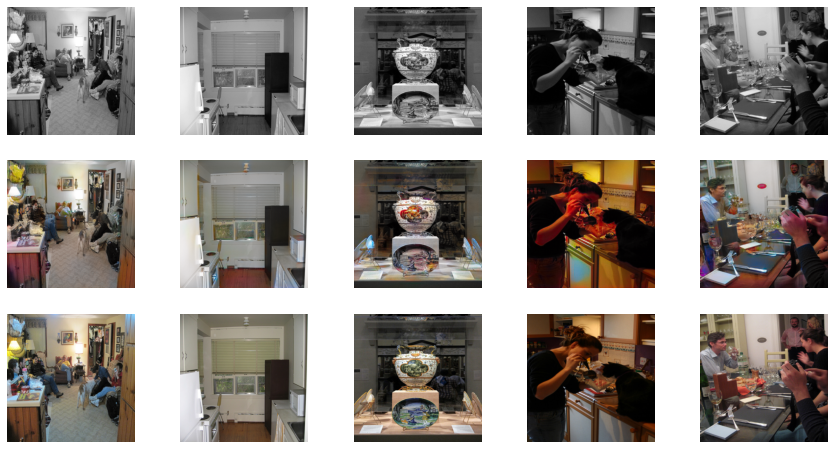


Epoch 14/20
Iteration 400/500
loss_D_fake: 0.59769
loss_D_real: 0.63589
loss_D: 0.61679
loss_G_GAN: 0.98385
loss_G_L1: 7.93347
loss_G: 8.91732


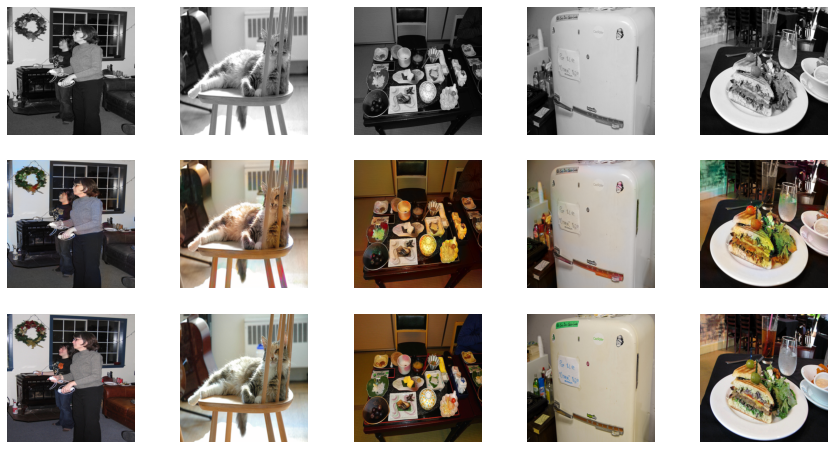

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/20
Iteration 200/500
loss_D_fake: 0.59557
loss_D_real: 0.63241
loss_D: 0.61399
loss_G_GAN: 0.97681
loss_G_L1: 7.81096
loss_G: 8.78778


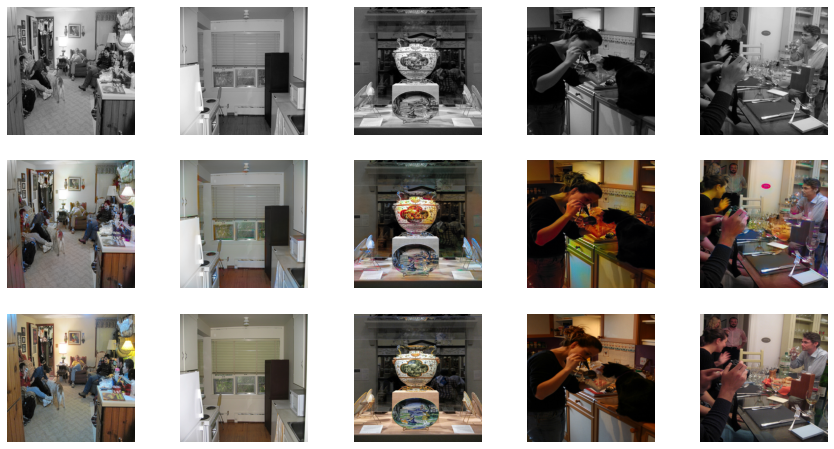


Epoch 15/20
Iteration 400/500
loss_D_fake: 0.60041
loss_D_real: 0.63493
loss_D: 0.61767
loss_G_GAN: 0.97506
loss_G_L1: 7.74854
loss_G: 8.72360


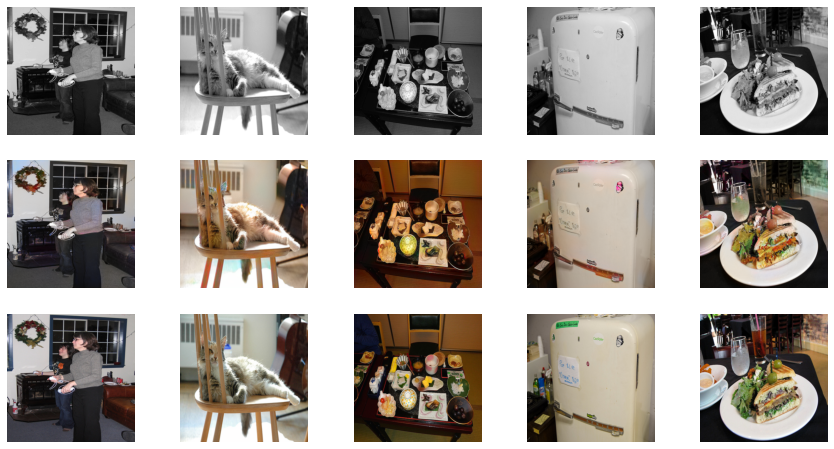

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/20
Iteration 200/500
loss_D_fake: 0.59693
loss_D_real: 0.63170
loss_D: 0.61431
loss_G_GAN: 0.96923
loss_G_L1: 7.65177
loss_G: 8.62100


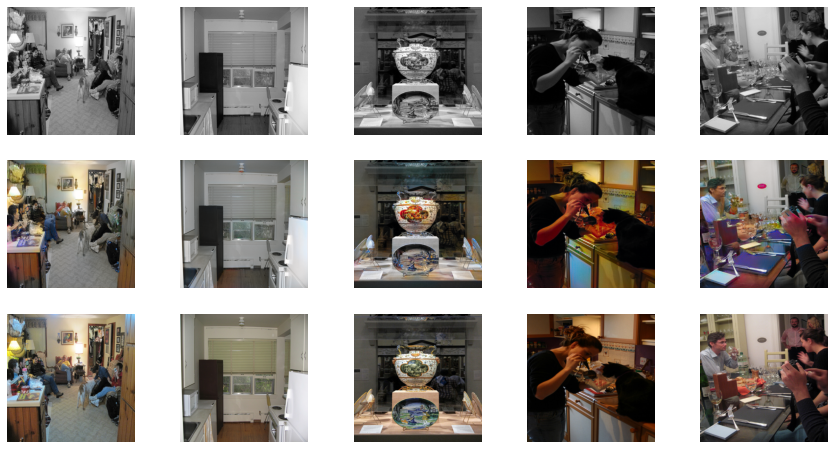


Epoch 16/20
Iteration 400/500
loss_D_fake: 0.60003
loss_D_real: 0.63389
loss_D: 0.61696
loss_G_GAN: 0.96888
loss_G_L1: 7.58486
loss_G: 8.55373


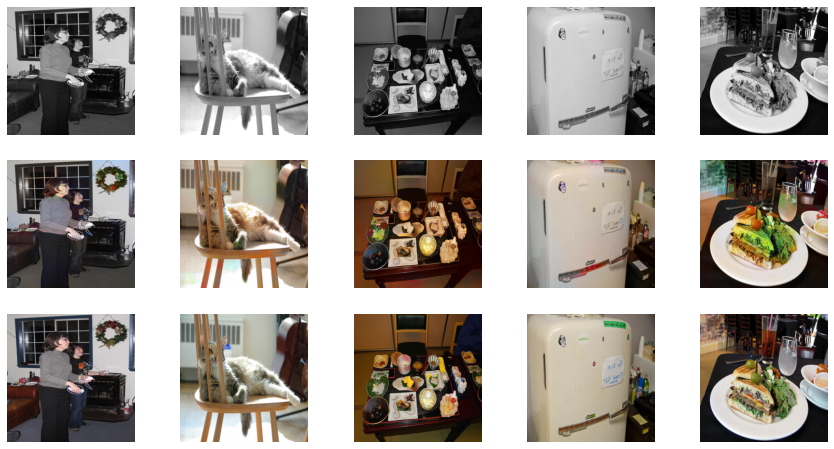

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/20
Iteration 200/500
loss_D_fake: 0.60387
loss_D_real: 0.63717
loss_D: 0.62052
loss_G_GAN: 0.96559
loss_G_L1: 7.48099
loss_G: 8.44658


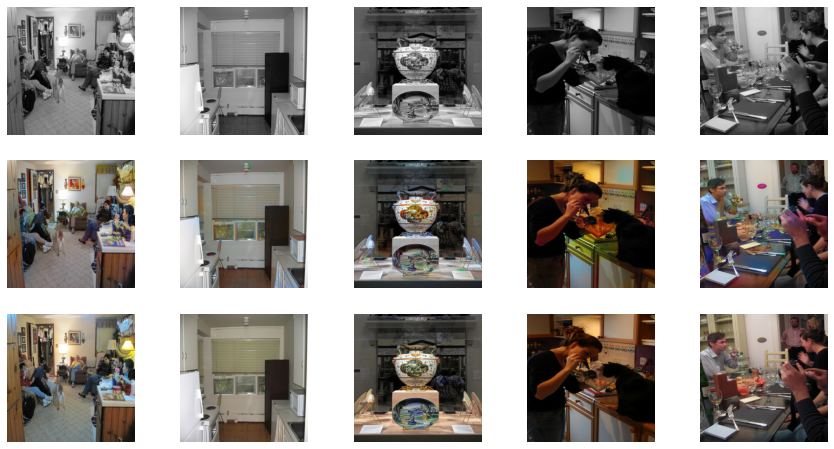


Epoch 17/20
Iteration 400/500
loss_D_fake: 0.60627
loss_D_real: 0.63765
loss_D: 0.62196
loss_G_GAN: 0.96361
loss_G_L1: 7.41399
loss_G: 8.37760


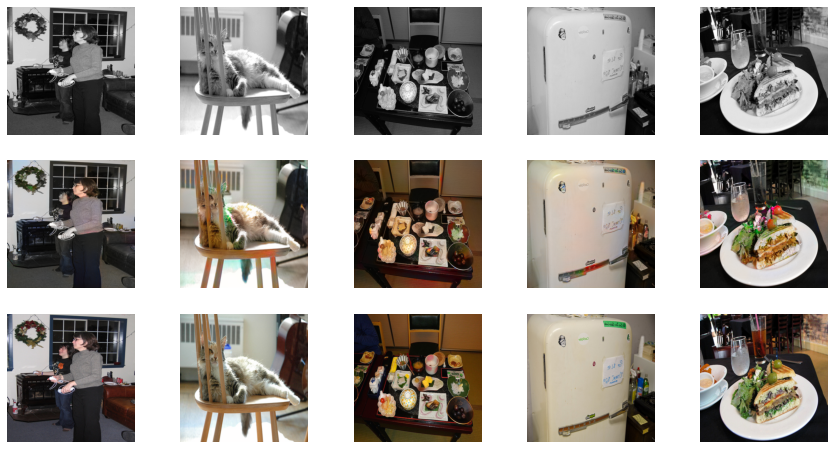

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/20
Iteration 200/500
loss_D_fake: 0.60646
loss_D_real: 0.63403
loss_D: 0.62025
loss_G_GAN: 0.95580
loss_G_L1: 7.35007
loss_G: 8.30587


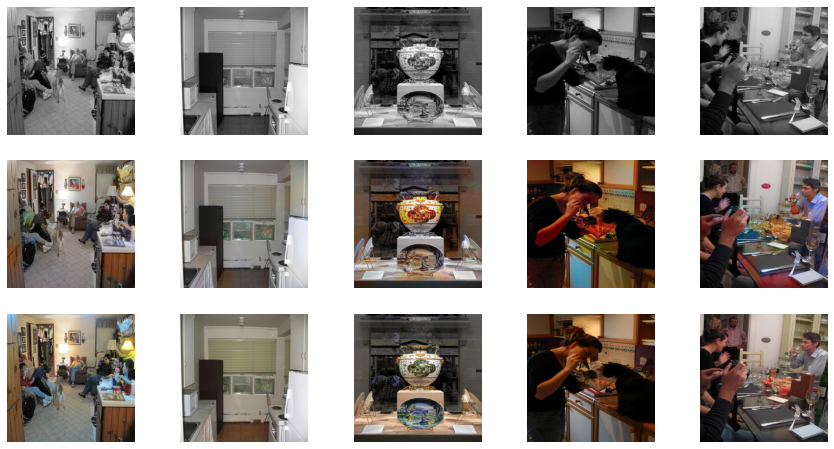


Epoch 18/20
Iteration 400/500
loss_D_fake: 0.60853
loss_D_real: 0.63635
loss_D: 0.62244
loss_G_GAN: 0.95133
loss_G_L1: 7.27102
loss_G: 8.22235


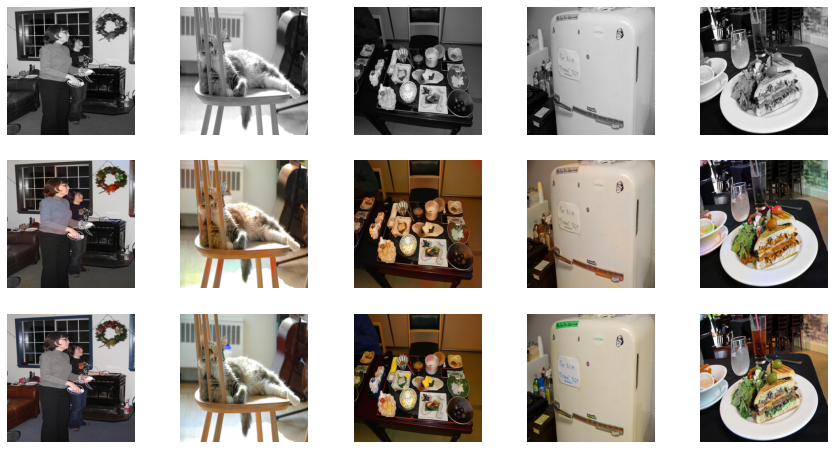

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/20
Iteration 200/500
loss_D_fake: 0.61254
loss_D_real: 0.63342
loss_D: 0.62298
loss_G_GAN: 0.95242
loss_G_L1: 7.16732
loss_G: 8.11974


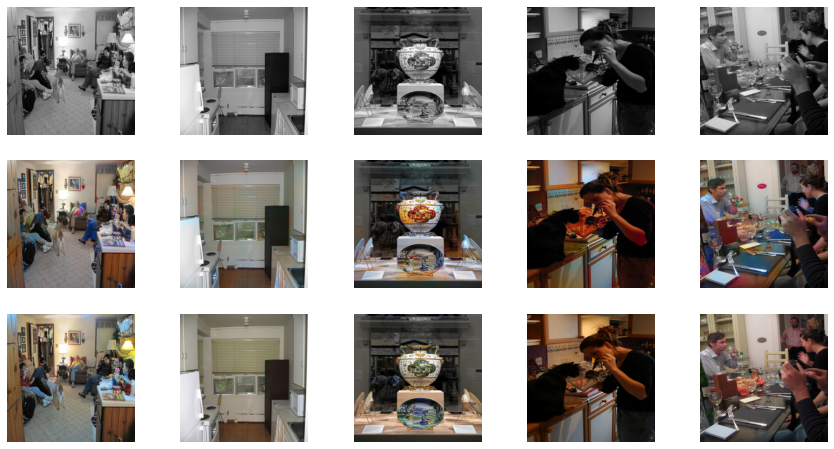


Epoch 19/20
Iteration 400/500
loss_D_fake: 0.61045
loss_D_real: 0.63473
loss_D: 0.62259
loss_G_GAN: 0.94449
loss_G_L1: 7.10911
loss_G: 8.05360


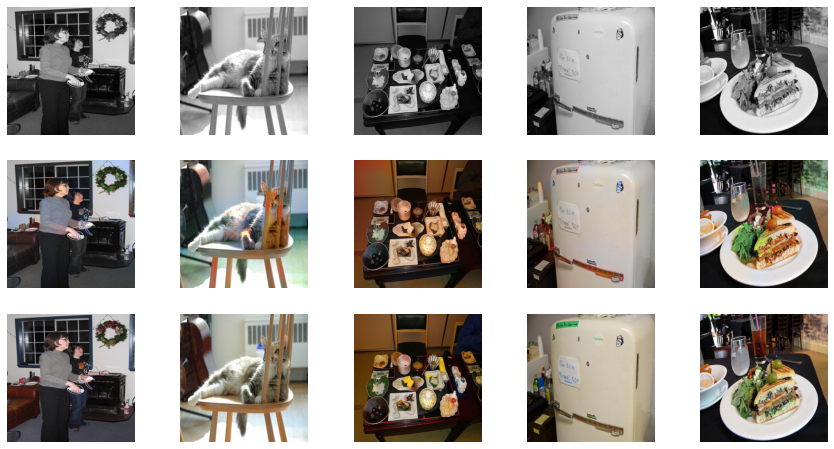

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/20
Iteration 200/500
loss_D_fake: 0.61082
loss_D_real: 0.63262
loss_D: 0.62172
loss_G_GAN: 0.94274
loss_G_L1: 7.00905
loss_G: 7.95179


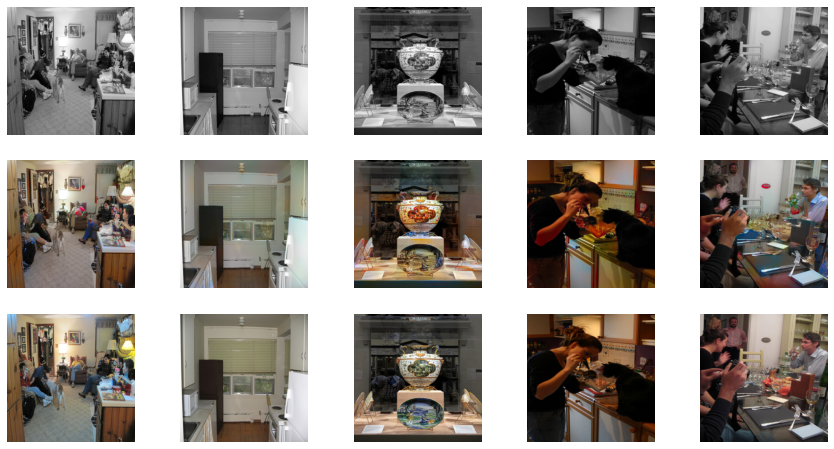


Epoch 20/20
Iteration 400/500
loss_D_fake: 0.61506
loss_D_real: 0.63521
loss_D: 0.62514
loss_G_GAN: 0.93931
loss_G_L1: 6.95216
loss_G: 7.89148


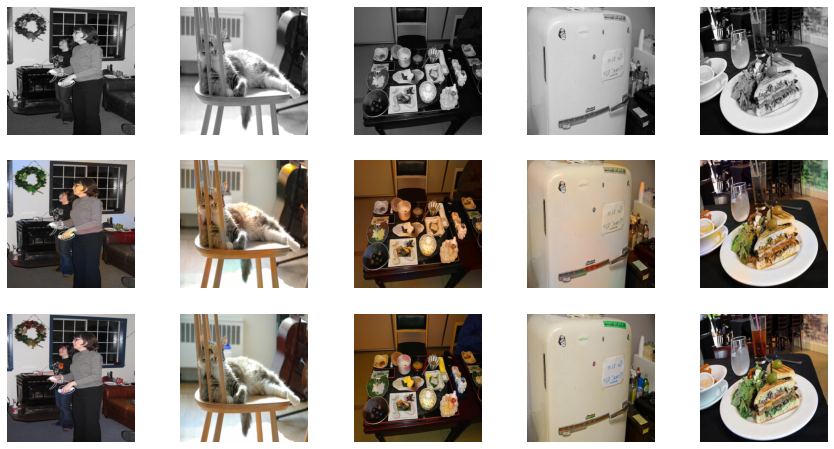

In [ ]:
net_G = build_res_unet(n_input=1, n_output=2, size=256)
net_G.load_state_dict(torch.load("res18-unet.pt", map_location=device))
model = MainModel(net_G=net_G)
train_model(model, train_dl, 20)

In [ ]:
torch.save(model.state_dict(), 'final_model.pt')

# Section 3: Implementing the Model

While the model can be evaluated on the test dataset, we chose to show direct implementation. You can follow these steps to use the model.

1. Create a folder in your Drive named sample_img. If you're using any other filename, do change the path in the code. These locations are market using the comment #CUSTOMIZABLE
2. Add the pretrained model to your drive folder
3. Run the cells as instructed

In [ ]:
from fastai.vision.all import *
from google.colab import files


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!gdown --id 1ubL7yxUSuT_ZelKCadgf83UAJwoQqywf #Incase you can't download it, click the drive link, download the file manually and upload it to your drive

/usr/local/lib/python3.8/dist-packages/gdown/cli.py:127: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Access denied with the following error:

 	Cannot retrieve the public link of the file. You may need to change
	the permission to 'Anyone with the link', or have had many accesses. 

You may still be able to access the file from the browser:

	 https://drive.google.com/uc?id=1ubL7yxUSuT_ZelKCadgf83UAJwoQqywf 



In [ ]:
uploaded= files.upload()  # Function that prompts for image to be uploaded

Saving image_2023-01-03_232942705.png to image_2023-01-03_232942705.png


In [ ]:
for file in uploaded.keys():
  print('Saved file with filename: "{name}" and length {length} bytes'.format(
      name=file, length=len(uploaded[file])))

Saved file with filename: "image_2023-01-03_232942705.png" and length 116193 bytes


In [ ]:
! mv "{file}" /content/drive/MyDrive/sample_img  #CUSTOMIZABLE #moves the file to your drive folder

In [ ]:
import PIL
import torch
from matplotlib import pyplot as plt
from torchvision import transforms


if __name__ == '__main__':
    model = MainModel(net_G=net_G)

    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model.load_state_dict(
        torch.load(
            "/content/drive/MyDrive/sample_img/final_model.pt",
            map_location=device
        )
    )
    path = "/content/drive/MyDrive/sample_img/vertical-closeup-grayscale-shot-fluffy-domestic-cat-sitting-floor_181624-35037.jpg" #CUSTOMIZABLE, ADD PATH OF THE IMAGE YOU WISH TO COLORIZE
    img = PIL.Image.open(path)
    img = img.resize((256, 256))
    image = img
    img = transforms.ToTensor()(img)[:1] * 2. - 1.
    # to make it between -1 and 1


model initialized with norm initialization


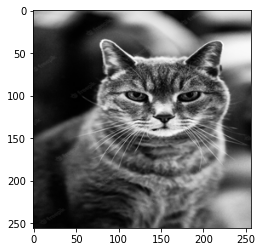

In [ ]:
plt.imshow(image)

<ipython-input-69-a5a71bdb8a69>:5: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  colorized = lab_to_rgb(img.unsqueeze(0), preds.cpu())[0]
<ipython-input-14-9d67ed3ddef9>:39: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  ab = ab * 110.
<ipython-input-14-9d67ed3ddef9>:40: UserWarning: Defining your `__torch_function__` as a plain method is deprecated and will be an error in future, please define it as a classmethod. (Triggered internally at ../torch/csrc/utils/python_arg_parser.cpp:350.)
  Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()


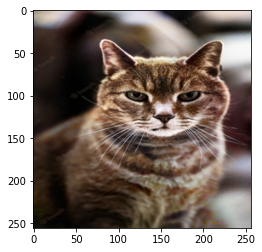

In [ ]:
#evaluating
model.eval()
with torch.no_grad():
    preds = model.net_G(img.unsqueeze(0).to(device))
    colorized = lab_to_rgb(img.unsqueeze(0), preds.cpu())[0]
    plt.imshow(colorized)

# Further improvements

We were thinking of implementing a web-interface for the given model that would take an uploaded image as a request and return the colorized image after appropriate transformations, but given the nature of the project and limited time, we chose to postpone it for now.
Overall, this project helped us learn how Deep Learning can be used to automate the task of image colorization